<a href="https://colab.research.google.com/github/LuwamMKefali/IPCV_Project/blob/main/assignment_module_one.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



---



# **Product Recognition of Books**

## Image Processing and Computer Vision - Assignment Module \#1


Contacts:

- Prof. Giuseppe Lisanti -> giuseppe.lisanti@unibo.it
- Prof. Samuele Salti -> samuele.salti@unibo.it
- Alex Costanzino -> alex.costanzino@unibo.it
- Francesco Ballerini -> francesco.ballerini4@unibo.it

Computer vision-based object detection techniques can be applied in library or bookstore settings to build a system that identifies books on shelves.

Such a system could assist in:
* Helping visually impaired users locate books by title/author;
* Automating inventory management (e.g., detecting misplaced or out-of-stock books);
* Enabling faster book retrieval by recognizing spine text or cover designs.

## Task
Develop a computer vision system that, given a reference image for each book, is able to identify such book from one picture of a shelf.

<figure>
<a href="https://ibb.co/pvLVjbM5"><img src="https://i.ibb.co/svVx9bNz/example.png" alt="example" border="0"></a>
</figure>

For each type of product displayed on the shelf, the system should compute a bounding box aligned with the book spine or cover and report:
1. Number of instances;
1. Dimension of each instance (area in pixel of the bounding box that encloses each one of them);
1. Position in the image reference system of each instance (four corners of the bounding box that enclose them);
1. Overlay of the bounding boxes on the scene images.

<font color="red"><b>Each step of this assignment must be solved using traditional computer vision techniques.</b></font>

#### Example of expected output
```
Book 0 - 2 instance(s) found:
  Instance 1 {top_left: (100,200), top_right: (110, 220), bottom_left: (10, 202), bottom_right: (10, 208), area: 230px}
  Instance 2 {top_left: (90,310), top_right: (95, 340), bottom_left: (24, 205), bottom_right: (23, 234), area: 205px}
Book 1 – 1 instance(s) found:
.
.
.
```

## Data
Two folders of images are provided:
* **Models**: contains one reference image for each product that the system should be able to identify;
* **Scenes**: contains different shelve pictures to test the developed algorithm in different scenarios.

## Evaluation criteria
1. **Clarity and conciseness**. Present your work in a readable way: format your code and comment every important step;

2. **Procedural correctness**. There are several ways to solve the assignment. Design your own sound approach and justify every decision you make;

3. **Correctness of results**. Try to solve as many instances as possible. You should be able to solve all the instances of the assignment, however, a thoroughly justified and sound procedure with a lower number of solved instances will be valued **more** than a poorly designed and justified approach that solves more or all instances.



---



# Problem statement

Our goal is not only to detect books, but to:
- Localize each instance with a quadrilateral
- Estimate its area in pixels
- Extract geometric corner coordinates

Which makes the problem both a **detection** and **geometric estimation** task.

We will first hanfle our images.

# Data and runtime setup

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip -q install opencv-contrib-python-headless

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.6/66.6 MB 11.4 MB/s eta 0:00:00


In [ ]:
import os, glob, json
import colorsys
import numpy as np
import cv2
import matplotlib.pyplot as plt
import re


cv2.setRNGSeed(42)
np.random.seed(42)

!cp -r "/content/drive/MyDrive/AssignmentsIPCV/dataset.zip" ./
!unzip -q dataset.zip

DATA_ROOT = "dataset"
MODELS_DIR = os.path.join(DATA_ROOT, "models")
SCENES_DIR = os.path.join(DATA_ROOT, "scenes")

model_paths = sorted([p for p in glob.glob(os.path.join(MODELS_DIR, "*.png")) if ".DS_Store" not in p])
scene_paths = sorted([p for p in glob.glob(os.path.join(SCENES_DIR, "*.jpg")) if ".DS_Store" not in p])

print("Models:", len(model_paths))
print("Scenes:", len(scene_paths))
print("Example:", model_paths[0], scene_paths[0])

replace dataset/.DS_Store? [y]es, [n]o, [A]ll, [N]one, [r]ename: N
Models: 22
Scenes: 29
Example: dataset/models/model_0.png dataset/scenes/scene_0.jpg


We sort the model and scene images numerically for easiier debugging and visualization.

In [ ]:
import re

def extract_id(path, prefix):
    name = os.path.basename(path)
    m = re.search(rf"{prefix}_(\d+)", name)
    if m is None:
        raise ValueError(f"Could not parse id from filename: {name}")
    return int(m.group(1))

model_paths = sorted(model_paths, key=lambda p: extract_id(p, "model"))
scene_paths = sorted(scene_paths, key=lambda p: extract_id(p, "scene"))

print("First 5 models:", [os.path.basename(p) for p in model_paths[:5]])
print("Last 5 models:",  [os.path.basename(p) for p in model_paths[-5:]])
print("First 5 scenes:", [os.path.basename(p) for p in scene_paths[:5]])
print("Last 5 scenes:",  [os.path.basename(p) for p in scene_paths[-5:]])

First 5 models: ['model_0.png', 'model_1.png', 'model_2.png', 'model_3.png', 'model_4.png']
Last 5 models: ['model_17.png', 'model_18.png', 'model_19.png', 'model_20.png', 'model_21.png']
First 5 scenes: ['scene_0.jpg', 'scene_1.jpg', 'scene_2.jpg', 'scene_3.jpg', 'scene_4.jpg']
Last 5 scenes: ['scene_24.jpg', 'scene_25.jpg', 'scene_26.jpg', 'scene_27.jpg', 'scene_28.jpg']


In [ ]:
for i in range(len(model_paths)):
    assert extract_id(model_paths[i], "model") == i, (i, os.path.basename(model_paths[i]))
print("Model indexing matches Book i!!")


Model indexing matches Book i!!


# Image I/O and preprocessing

Let's visualize model and scene images. Since there are limited images it would be beneficial to inspect the type of images and surrounding we are dealing with. We also think it will help us in deciding the CV techniques we can employ depending on image quality,orientation, lighting variations and/or noises.

we apply:
- **bilateral filtering**: reduces noise but keeps edges,
- **CLAHE**: increases local contrast, making text strokes more detectable.



In [ ]:
def imread_gray(path):
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        raise FileNotFoundError(path)
    return img

def imread_rgb(path):
    bgr = cv2.imread(path, cv2.IMREAD_COLOR)
    if bgr is None:
        raise FileNotFoundError(path)
    return cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)

def preprocess(gray, d, sigmaColor, sigmaSpace, clipLimit, tileGridSize):
    # cleaning noise but keeping edges, then boosting local contrast
    den = cv2.bilateralFilter(gray, d=d, sigmaColor=sigmaColor, sigmaSpace=sigmaSpace)
    clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=tileGridSize)
    out = clahe.apply(den)
    out = cv2.normalize(out, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    return out

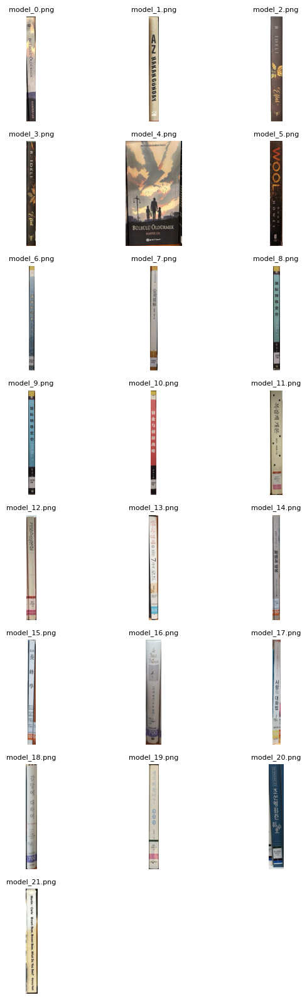

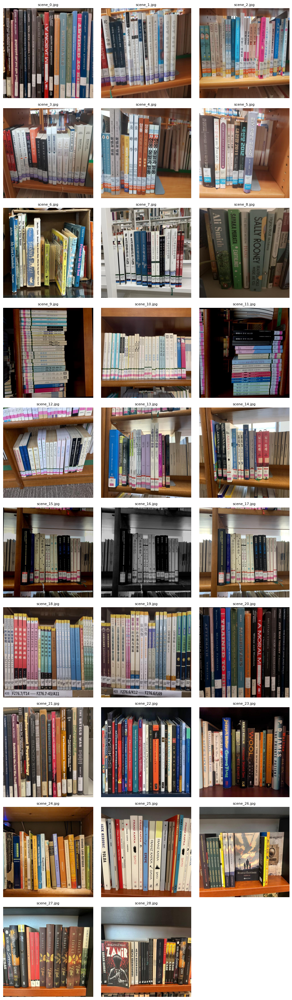

In [ ]:
import math

def show_all_images(paths, cols=6, title_prefix="", figsize_per_row=2.3):
    # showing all images
    imgs = [imread_rgb(p) for p in paths]
    titles = [os.path.basename(p) for p in paths]

    n = len(imgs)
    rows = math.ceil(n / cols)
    figsize = (cols*figsize_per_row, rows*figsize_per_row)

    plt.figure(figsize=figsize)
    for i, (img, t) in enumerate(zip(imgs, titles)):
        ax = plt.subplot(rows, cols, i+1)
        ax.imshow(img)
        ax.set_title(f"{title_prefix}{t}", fontsize=8)
        ax.axis("off")
    plt.tight_layout()
    plt.show()

show_all_images(model_paths, cols=3, title_prefix="", figsize_per_row=2.0)
show_all_images(scene_paths, cols=3, title_prefix="", figsize_per_row=3.2)

In [ ]:
def show(img, title="", cmap=None, figsize=(8,6)):
    plt.figure(figsize=figsize)
    if cmap is None:
        plt.imshow(img)
    else:
        plt.imshow(img, cmap=cmap)
    plt.title(title)
    plt.axis("off")
    plt.show()

We will inspect specific samples to analyse the effects preprocessing.

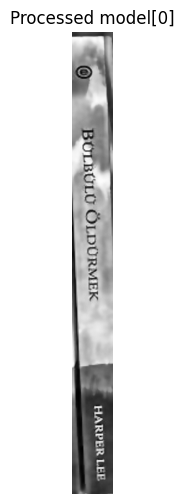

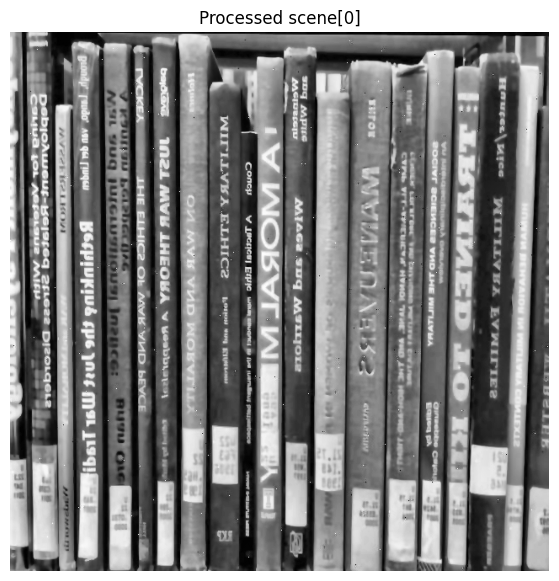

In [ ]:
# load originals
models_original = [imread_gray(p) for p in model_paths]
scenes_original = [imread_gray(p) for p in scene_paths]

# preprocess with slightly different params (models vs scenes)
# we know scenes are more cluttered, variable intensities, occlusions
models_proc = [preprocess(m, d=9, sigmaColor=20, sigmaSpace=20, clipLimit=2.5, tileGridSize=(8,8)) for m in models_original]
scenes_proc = [preprocess(s, d=5, sigmaColor=20, sigmaSpace=10, clipLimit=3.2, tileGridSize=(12,12)) for s in scenes_original]

# quick visualization
show(models_proc[0], "Processed model[0]", cmap="gray")
show(scenes_proc[0], "Processed scene[0]", cmap="gray", figsize=(10,7))

# Core idea
Books are approximately planar objects, so a correct match between a model and a scene region is described by a **homography**. Moreover, after analyzing the books, we notice rotations, varying scales as well as lighting or illumination differences. To cater to these variances, we choose SIFT for its invariance to rotation and scale, and partial invariance to illumination.

We therefore:
1. detect local features (SIFT) in model + scene,
2. match descriptors (FLANN + ratio test),
3. estimate a homography using RANSAC,
4. project model corners into the scene to obtain a 4-corner bounding polygon.

## Multiple instances
If a scene contains multiple copies of the same book, we repeatedly:
- detect one instance,
- remove scene keypoints that fall **inside** the detected polygon,
- run matching again to find the next instance.

This prevents rediscovering the same instance and reduces overlapping detections.

# Feature extraction (SIFT)

After preprocessing, we compute SIFT keypoints and descriptors for every model and every scene.


In [ ]:
# More features in the scene helps recall (scenes are harder given lighting + clutter + repeated textures)
sift_model = cv2.SIFT_create(

    sigma=1.6,
    contrastThreshold=0.06,
    edgeThreshold=10,
    nOctaveLayers=20
)

sift_scene = cv2.SIFT_create(

    sigma=1.2,
    contrastThreshold=0.03,
    edgeThreshold=6,
    nOctaveLayers=20
)

def compute_sift(img, which="scene"):
    if which == "model":
        kp, des = sift_model.detectAndCompute(img, None)
    else:
        kp, des = sift_scene.detectAndCompute(img, None)
    if des is None:
        des = np.empty((0,128), dtype=np.float32)
    return kp, des

kp_models, des_models = [], []
for m in models_proc:
    kp, des = compute_sift(m, which="model")
    kp_models.append(kp)
    des_models.append(des)

kp_scenes, des_scenes = [], []
for s in scenes_proc:
    kp, des = compute_sift(s, which="scene")
    kp_scenes.append(kp)
    des_scenes.append(des)

This printout is a quick sanity check that:
- each image produces a reasonable number of keypoints,
- descriptor arrays have the expected shape `(num_keypoints, 128)`.

In [ ]:
def print_feature_stats(paths, kps_list, des_list, label_prefix=""):
    for p, kps, des in zip(paths, kps_list, des_list):
        name = os.path.basename(p)
        kps_n = len(kps)
        des_shape = des.shape if des is not None else None
        print(f"{label_prefix}{name}: kps = {kps_n}, des = {des_shape}")

print("SCENES")
print_feature_stats(scene_paths, kp_scenes, des_scenes, label_prefix="")

print("\n MODELS")
print_feature_stats(model_paths, kp_models, des_models, label_prefix="")

SCENES
scene_0.jpg: kps = 9250, des = (9250, 128)
scene_1.jpg: kps = 7474, des = (7474, 128)
scene_2.jpg: kps = 13753, des = (13753, 128)
scene_3.jpg: kps = 11200, des = (11200, 128)
scene_4.jpg: kps = 11178, des = (11178, 128)
scene_5.jpg: kps = 9233, des = (9233, 128)
scene_6.jpg: kps = 14238, des = (14238, 128)
scene_7.jpg: kps = 13180, des = (13180, 128)
scene_8.jpg: kps = 4746, des = (4746, 128)
scene_9.jpg: kps = 10442, des = (10442, 128)
scene_10.jpg: kps = 14476, des = (14476, 128)
scene_11.jpg: kps = 9487, des = (9487, 128)
scene_12.jpg: kps = 30384, des = (30384, 128)
scene_13.jpg: kps = 13116, des = (13116, 128)
scene_14.jpg: kps = 11025, des = (11025, 128)
scene_15.jpg: kps = 8173, des = (8173, 128)
scene_16.jpg: kps = 8080, des = (8080, 128)
scene_17.jpg: kps = 11490, des = (11490, 128)
scene_18.jpg: kps = 20937, des = (20937, 128)
scene_19.jpg: kps = 18033, des = (18033, 128)
scene_20.jpg: kps = 8228, des = (8228, 128)
scene_21.jpg: kps = 9167, des = (9167, 128)
scene_22.

## Visualizing keypoints and descriptors

- **Keypoints** are shown as circles with orientation. This helps confirm that SIFT is detecting stable structure on the book spine text and edges.
- **Descriptors** are 128-D vectors, so we don't plot them directly. Instead, we visualize a **pairwise distance heatmap** of a small sample of descriptors to confirm they contain diverse information (not all identical / not all noise).


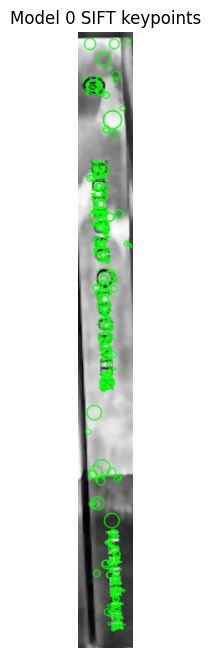

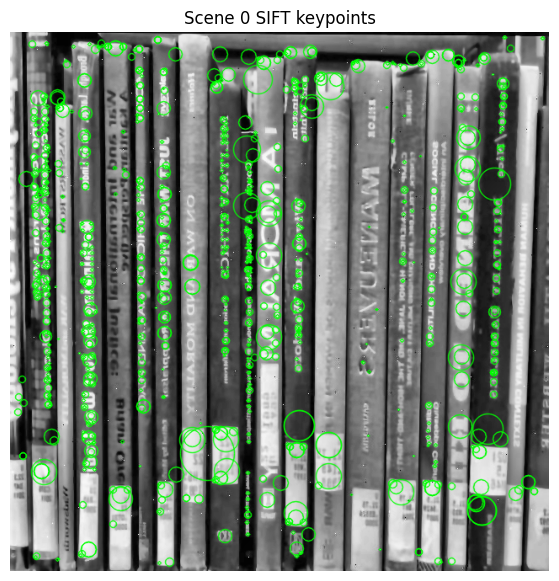

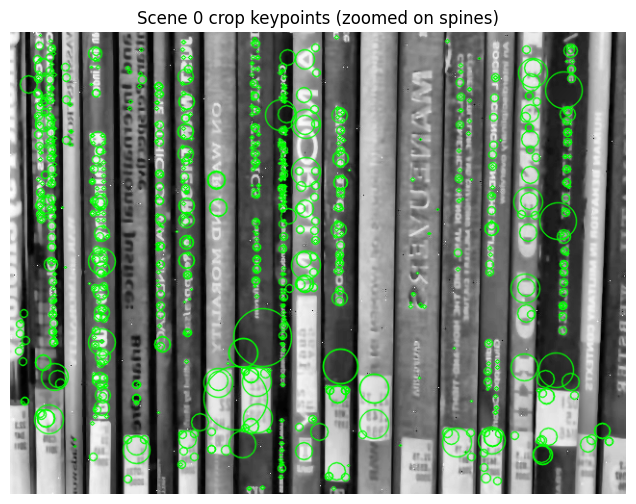

In [ ]:
def draw_keypoints(gray_img, kps, max_draw=800, radius_scale=0.5):
    """
    THis draw SIFT keypoints in uniform green.
    Circle radius is proportional to keypoint scale.
    """
    vis = cv2.cvtColor(gray_img, cv2.COLOR_GRAY2BGR)

    # sort by response so we keep the strongest points
    kps_sorted = sorted(kps, key=lambda k: -k.response)[:max_draw]

    for kp in kps_sorted:
        x, y = int(round(kp.pt[0])), int(round(kp.pt[1]))
        r = max(1, int(round(radius_scale * kp.size)))
        cv2.circle(vis, (x, y), r, (0, 255, 0), 1, cv2.LINE_AA)

    return cv2.cvtColor(vis, cv2.COLOR_BGR2RGB)

def crop_view(gray, x1, y1, x2, y2):
    x1 = max(0, int(x1)); y1 = max(0, int(y1))
    x2 = min(gray.shape[1], int(x2)); y2 = min(gray.shape[0], int(y2))
    return gray[y1:y2, x1:x2]

mid = 0
sid = 0

model_gray = models_proc[mid]
scene_gray = scenes_proc[sid]

kpM, desM = kp_models[mid], des_models[mid]
kpS, desS = kp_scenes[sid], des_scenes[sid]

show(
    draw_keypoints(model_gray, kpM, max_draw=700),
    f"Model {mid} SIFT keypoints",
    figsize=(5,8)
)

show(
    draw_keypoints(scene_gray, kpS, max_draw=1200),
    f"Scene {sid} SIFT keypoints",
    figsize=(10,7)
)

# optionalzoom into the shelf region
# these coordinates are in (x,y) pixels for the scene image
x1, y1, x2, y2 = 0, 120, scene_gray.shape[1], scene_gray.shape[0]-40
scene_crop = crop_view(scene_gray, x1, y1, x2, y2)

# recompute keypoints on the crop so we can see spine detail clearly
kpC, desC = compute_sift(scene_crop, which="scene")
show(draw_keypoints(scene_crop, kpC, max_draw=1200),
     f"Scene {sid} crop keypoints (zoomed on spines)", figsize=(10,6))


For clarity, all SIFT keypoints are visualized using a **uniform green color**.
OpenCV’s default visualization assigns arbitrary colors to keypoints, which were hard to analyze and even see.

Using a single color improves readability and avoids visual ambiguity, while the
circle radius still reflects the keypoint scale.


In [ ]:
def show_keypoints(images, keypoints, titles,
                        cols=5, max_draw=600,
                        figsize_per_cell=(3,4)):
    """
    Displays images with SIFT keypoints in a grid.
    """
    n = len(images)
    rows = math.ceil(n / cols)

    fig_w = cols * figsize_per_cell[0]
    fig_h = rows * figsize_per_cell[1]

    plt.figure(figsize=(fig_w, fig_h))

    for i, (img, kps, title) in enumerate(zip(images, keypoints, titles)):
        ax = plt.subplot(rows, cols, i+1)
        vis = draw_keypoints(img, kps, max_draw=max_draw)
        ax.imshow(vis)
        ax.set_title(title, fontsize=9)
        ax.axis("off")

    plt.tight_layout()
    plt.show()


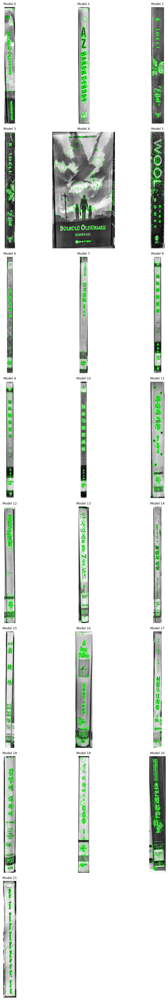

In [ ]:
# visualize all models with keypoints
model_titles = [f"Model {i}" for i in range(len(models_proc))]

show_keypoints(
    images=models_proc,
    keypoints=kp_models,
    titles=model_titles,
    cols=3,
    max_draw=600,
    figsize_per_cell=(3,5)
)

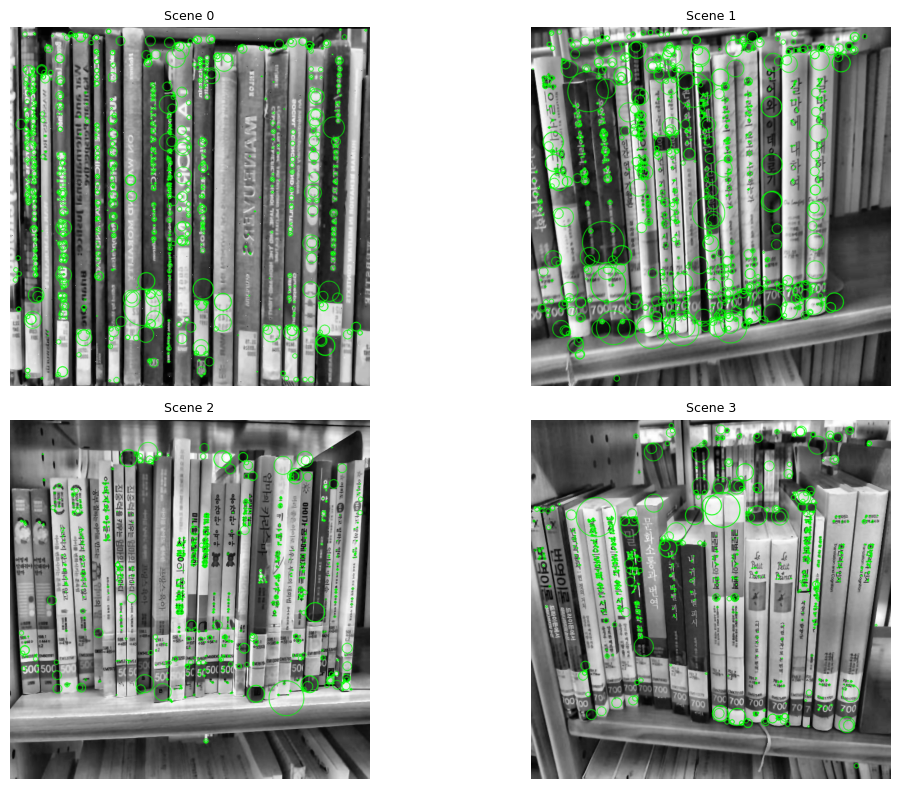

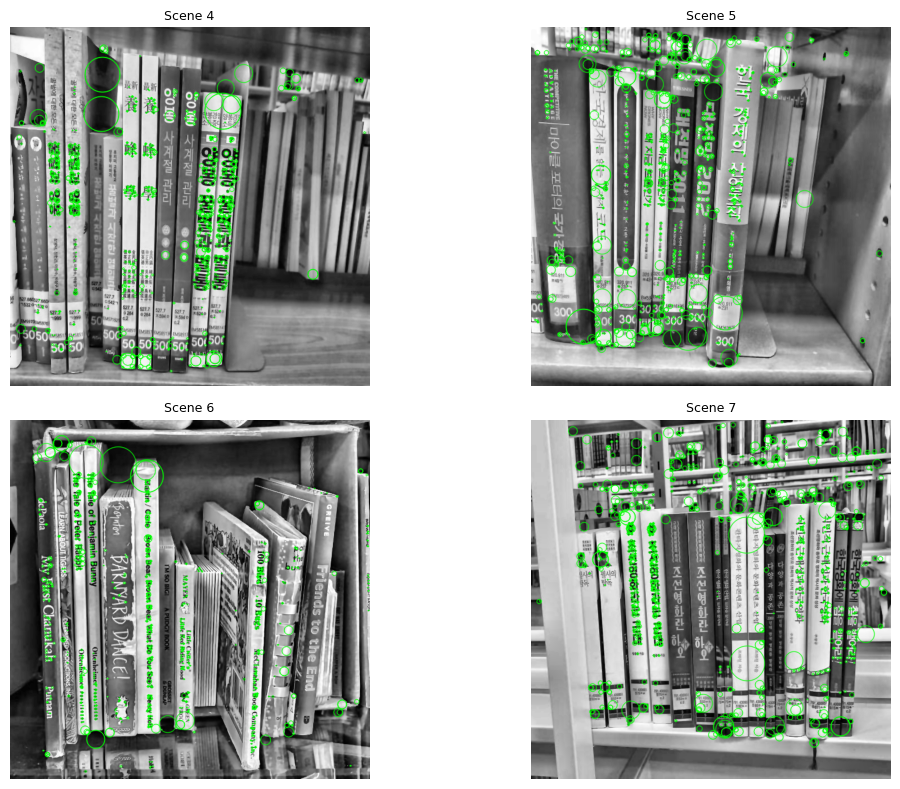

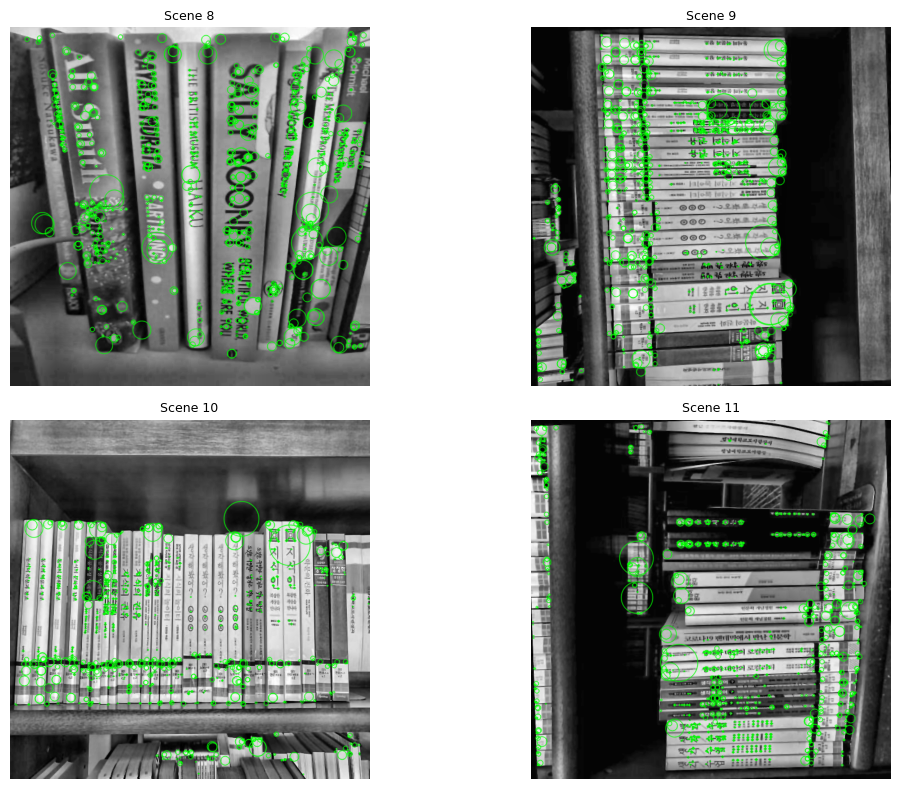

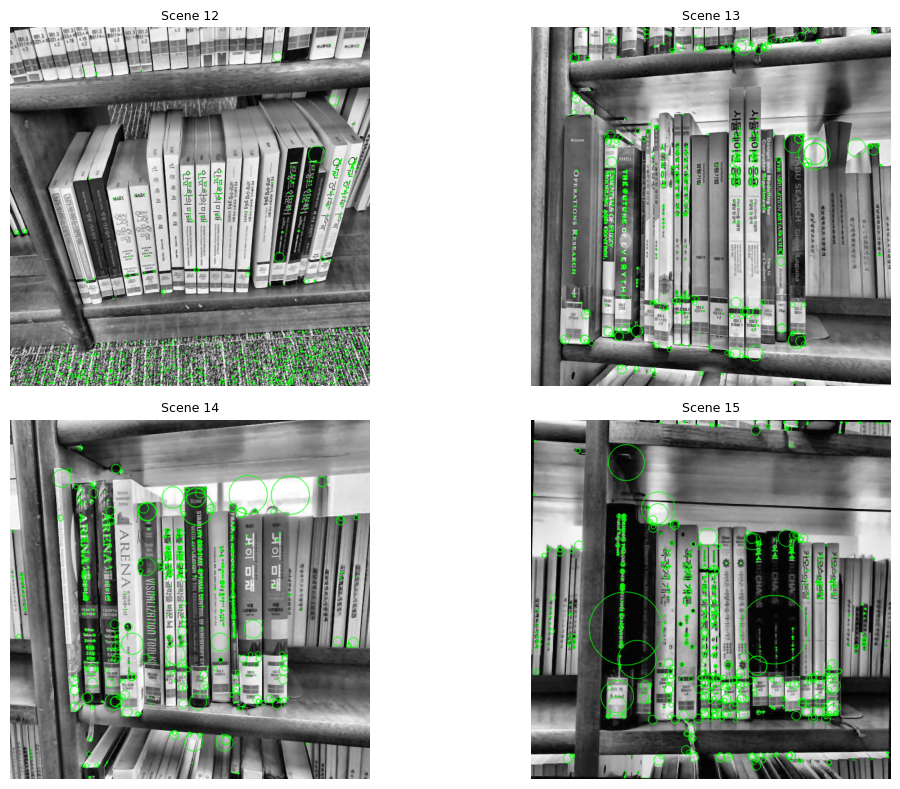

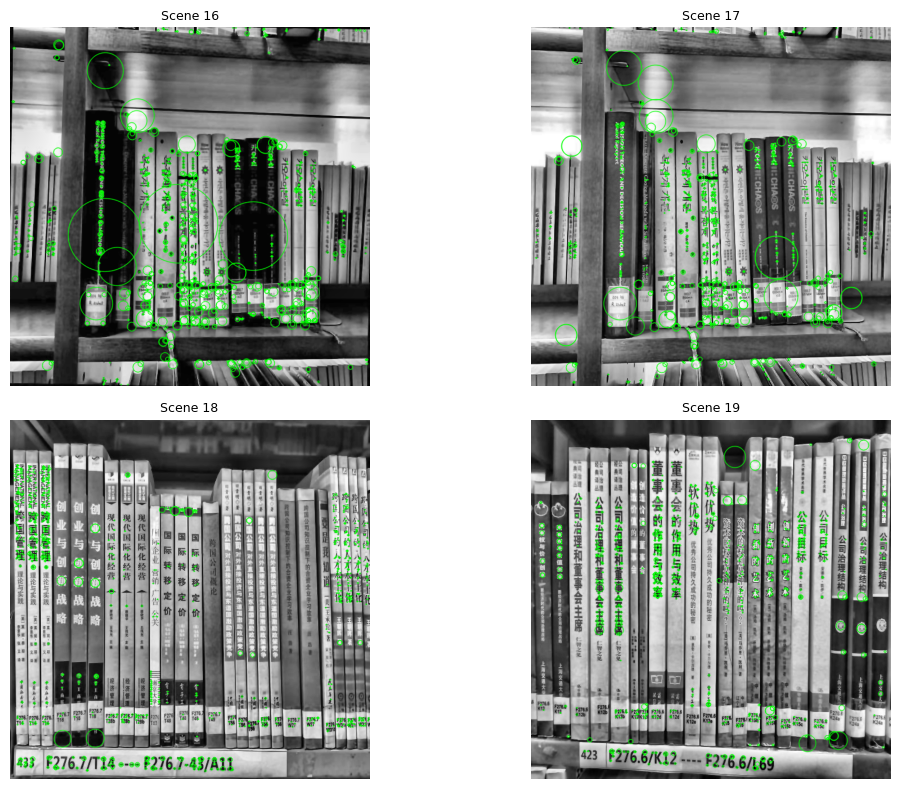

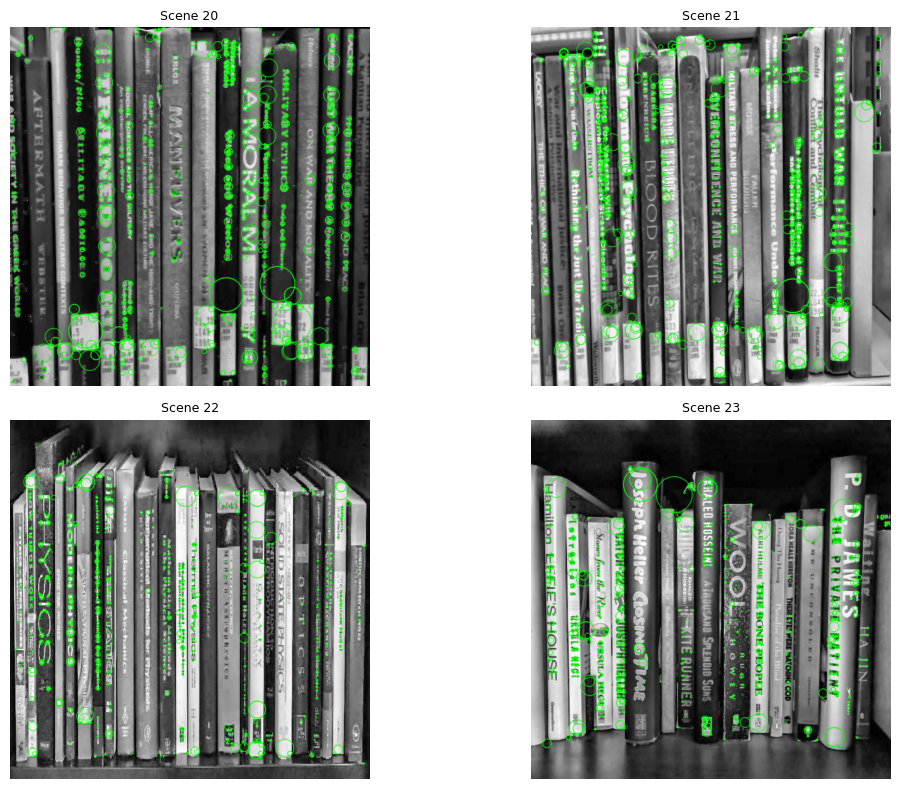

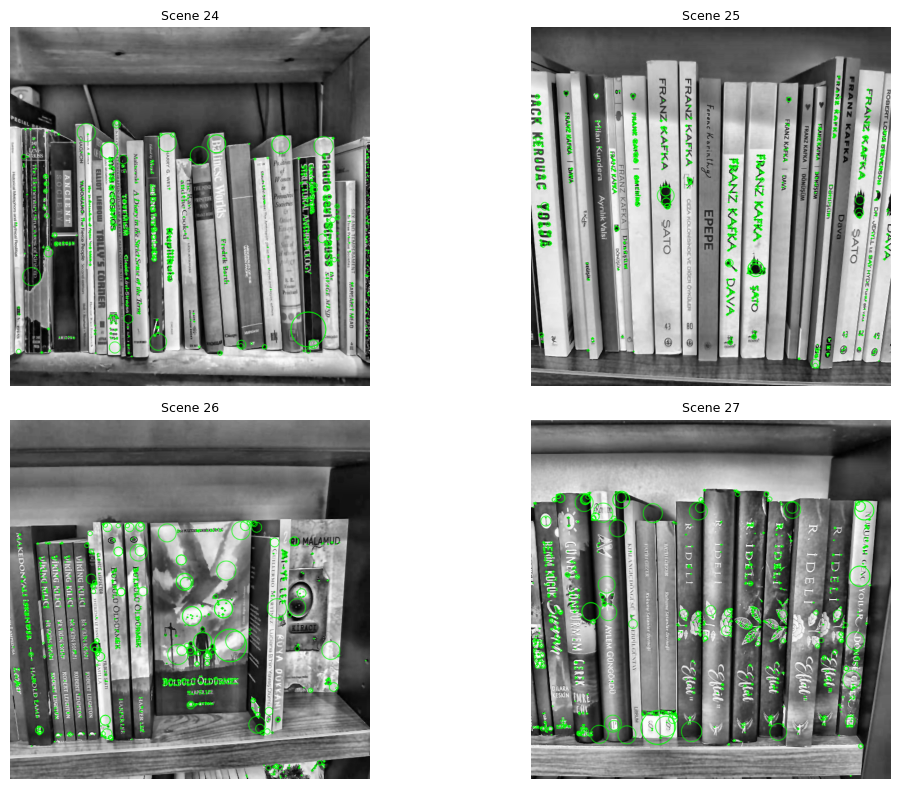

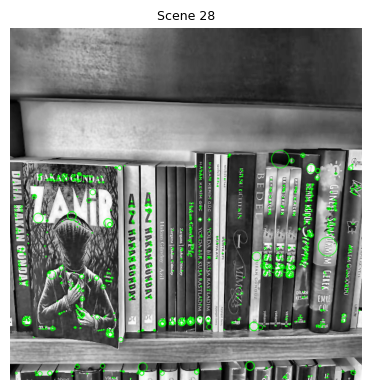

In [ ]:
def show_scene(scenes, keypoints, page_size=4, max_draw=1200):
    n = len(scenes)
    pages = math.ceil(n / page_size)

    for p in range(pages):
        start = p * page_size
        end = min((p+1) * page_size, n)

        imgs = scenes[start:end]
        kps = keypoints[start:end]
        titles = [f"Scene {i}" for i in range(start, end)]

        show_keypoints(
            images=imgs,
            keypoints=kps,
            titles=titles,
            cols=2,
            max_draw=max_draw,
            figsize_per_cell=(6,4)
        )

# visualize all scenes with keypoints
show_scene(
    scenes=scenes_proc,
    keypoints=kp_scenes,
    page_size=4,
    max_draw=1400
)

## Descriptor visualization

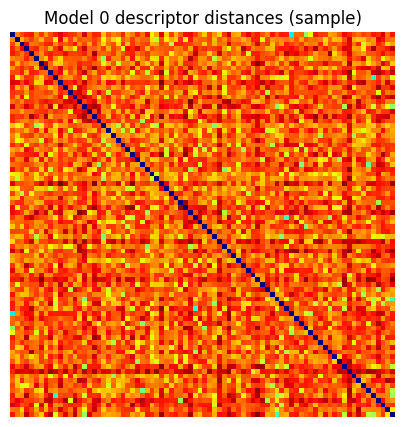

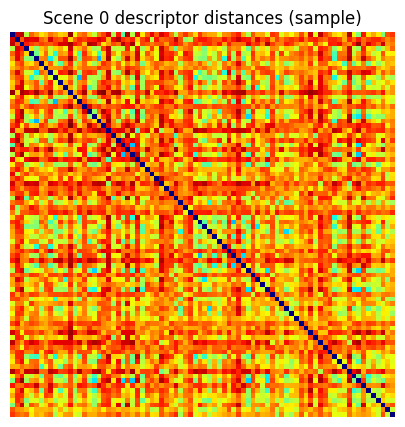

In [ ]:
def descriptor_heatmap(des, sample=80, seed=0, title="Descriptor distance heatmap"):
    if des is None or len(des) == 0:
        print("No descriptors to show.")
        return

    rng = np.random.default_rng(seed)
    n = len(des)
    k = min(sample, n)

    idx = rng.choice(n, size=k, replace=False)
    X = des[idx].astype(np.float32)

    # pairwise L2 distances (k x k)
    # (X[:,None,:] - X[None,:,:]) -> (k,k,128)
    D = np.linalg.norm(X[:, None, :] - X[None, :, :], axis=2)

    plt.figure(figsize=(6,5))
    plt.imshow(D, cmap="jet")
    plt.title(title)
    plt.axis("off")
    plt.show()

# heatmap for a subset of model descriptors
descriptor_heatmap(desM, sample=80, seed=1, title=f"Model {mid} descriptor distances (sample)")

# heatmap for a subset of scene descriptors
descriptor_heatmap(desS, sample=80, seed=2, title=f"Scene {sid} descriptor distances (sample)")


The descriptor heatmap shows:


*   Strong diagonal - descriptors are well defined and not degenerate
*   Good descriptor diversity means better matching robustness
*   Thus there are few highly redundant features





# Core detector

## Geometric Utility Functions

`order_corners` ensures that the four detected corner points are consistently ordered
(top-left → top-right → bottom-right → bottom-left).  
This is necessary for stable area computation and consistent geometric validation.

`poly_area` computes the area of a quadrilateral using the shoelace formula.  
This allows filtering of very small or degenerate detections. We quried how we could calculate the area of a simple polygon from its vertex coordinates.

In [ ]:
def order_corners(pts4):
    # Ensure the four points are always ordered:
    # top-left, top-right, bottom right, bottom-left
    # This keeps geometry consistent for later checks
    pts = np.array(pts4, dtype=np.float32)
    s = pts.sum(axis=1)          # smallest sum -> top-left, largest -> bottom-right
    d = np.diff(pts, axis=1)     # smallest diff -> top-right, largest -> bottom-left
    tl = pts[np.argmin(s)]
    br = pts[np.argmax(s)]
    tr = pts[np.argmin(d)]
    bl = pts[np.argmax(d)]
    return np.array([tl, tr, br, bl], dtype=np.float32)

def poly_area(quad):
    # used to reject very small or collapsed detections.
    q = np.array(quad, dtype=np.float32)
    x = q[:,0]; y = q[:,1]
    return 0.5 * abs(np.dot(x, np.roll(y,-1)) - np.dot(y, np.roll(x,-1)))

## Duplicate Suppression via Intersection over Union (IoU)

To prevent repeated detections of the same book instance, theoverlap between detected quadrilaterals is measured using [Intersection over Union (IoU)](https://www.researchgate.net/publication/220659463_The_Pascal_Visual_Object_Classes_VOC_challenge)

$$
\text{IoU} = \frac{\text{Area of Intersection}}{\text{Area of Union}}
$$

IoU is widely used in object detection to quantify overlap between predicted regions.  
Detections with high overlap are considered duplicates and suppressed.



In [ ]:
def quad_iou(q1, q2):
    poly1 = cv2.convexHull(q1.astype(np.float32))
    poly2 = cv2.convexHull(q2.astype(np.float32))

    inter_area, _ = cv2.intersectConvexConvex(poly1, poly2)
    if inter_area <= 0:
        return 0.0

    area1 = poly_area(q1)
    area2 = poly_area(q2)
    union = area1 + area2 - inter_area
    return inter_area / (union + 1e-6)

## Multi-Instance Detection/Matching

The following function implements the complete detection pipeline for locating multiple instances of a book template.

Our design follows these principles:

**1. Feature Matching (SIFT + FLANN)**  
Local invariant features are matched using FLANN-based nearest-neighbor search(KD-tree).  
A **Lowe's** ratio test and mutual nearest-neighbor filtering are applied to suppress ambiguous correspondences and improve match reliability.

**2. Robust Homography Estimation (RANSAC)**  
Since books are planar objects, their appearance transformation can be modeled with a homography.  
RANSAC is used to estimate the homography while rejecting outlier matches, whilst ensuring geometric consistency.

**3. Inlier and Reprojection Validation**  
Detections are validated using:
- Adaptive minimum matches (proportional to model keypoint count)
- Minimum inlier count  
- Minimum inlier ratio  
- Median reprojection error  

This prevents unstable or weak geometric fits.

**4. Quadrilateral Validation**  
The template corners are projected into the scene to obtain a quadrilateral.  
Geometric constraints (area threshold, width consistency, non degeneracy) are enforced to reject projections that are unrealistic. (we had instances of weird trapezoidal shapes)

**5. Duplicate Suppression & Iterative Detection**  
After detecting one instance, scene keypoints inside the detected region are removed and matching is repeated.  
This enables multi-instance detection while preventing repeated detections of the same book.

These constraints ensure that detections are supported by strong geometric evidence.

In [ ]:
def detect_multiple_instances(model_idx, scene_idx,
                              ratio=0.82,
                              ransac_thr=3.0,
                              min_inlier_ratio=0.26,
                              min_inliers=5,
                              max_instances=10,
                              debug=False):
    # model data
    img_model = models_proc[model_idx]
    kpM = kp_models[model_idx]
    desM = des_models[model_idx]

    # scene data
    img_scene = scenes_proc[scene_idx]
    kpS = list(kp_scenes[scene_idx])
    desS = np.copy(des_scenes[scene_idx])

    # FLANN for SIFT descriptors
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=80)
    search_params = dict(checks=220)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    h, w = img_model.shape[:2]
    model_corners = np.float32([[0,0],[0,h-1],[w-1,h-1],[w-1,0]]).reshape(-1,1,2)

    # small models can have few keypoints, so the requirement must not explode
    min_matches_required = max(6, min(35, int(0.02 * len(kpM))))

    quads = []
    instance = 0

    while instance < max_instances:
        if len(desS) < 2 or len(desM) < 2:
            break

        ratio_list = [ratio]

        best_good = None
        for r in ratio_list:
            matches12 = flann.knnMatch(desM, desS, k=2)
            matches21 = flann.knnMatch(desS, desM, k=2)

            # ratio test in both directions
            good12 = []
            for m, n in matches12:
                if m.distance < r * n.distance:
                    good12.append(m)

            good21 = {}
            for m, n in matches21:
                if m.distance < r * n.distance:
                    # for each scene descriptor index to remember the model index it prefers
                    good21[m.queryIdx] = m.trainIdx

            # mutual nearest neighbor filter (keeps only consistent pairs)
            mutual = []
            for m in good12:
                if good21.get(m.trainIdx, None) == m.queryIdx:
                    mutual.append(m)

            if len(mutual) >= min_matches_required:
                best_good = mutual
                break

        if best_good is None:
            break

        src = np.float32([kpM[m.queryIdx].pt for m in best_good]).reshape(-1,1,2)
        dst = np.float32([kpS[m.trainIdx].pt for m in best_good]).reshape(-1,1,2)

        H, mask = cv2.findHomography(src, dst, cv2.RANSAC, ransac_thr, maxIters=5000, confidence=0.995)
        if H is None or mask is None:
            break
        if not np.isfinite(H).all():
          break

        mask = mask.ravel().astype(bool)

        src_in = src[mask]
        dst_in = dst[mask]

        inliers = int(mask.sum())
        inlier_ratio = inliers / (len(best_good) + 1e-6)
        med_rep = reprojection_median_error(H, src_in, dst_in)

        min_ratio_now = min_inlier_ratio

        # adapt based on match strength
        if len(best_good) < 30:
            min_inliers_now = 8
        else:
            min_inliers_now = min_inliers

        max_med_rep = 4.0

        if inliers < min_inliers_now or inlier_ratio < min_ratio_now or med_rep > max_med_rep:
          instance += 1
          continue

        quad = cv2.perspectiveTransform(model_corners, H).reshape(4,2)
        quad = order_corners(quad)

        # reject degenerate / collapsed quads
        tl, tr, br, bl = quad

        top_width = np.linalg.norm(tr - tl)
        bottom_width = np.linalg.norm(br - bl)
        left_height = np.linalg.norm(bl - tl)
        right_height = np.linalg.norm(br - tr)

        # width collapse check
        if top_width < 8 or bottom_width < 8:
            break

        # extreme trapezoid check
        if max(top_width, bottom_width) / (min(top_width, bottom_width) + 1e-6) > 3:
            break

        area = poly_area(quad)
        if area < 600:
            break

        duplicate = False
        for q_prev in quads:
            if quad_iou(quad, q_prev) > 0.4: # 50% overlap threshold
                duplicate = True
                break

        if duplicate:
            break

        quads.append(quad)

        if debug:
            print(f"instance {instance+1}: matches={len(best_good)} inliers={inliers} ratio={inlier_ratio:.2f} med_rep={med_rep:.2f} area={area:.0f}")

        # remove scene keypoints inside detected polygon (prevents repeats)
        poly = quad.astype(np.int32).reshape(-1,2)
        new_kp, new_des = [], []

        for kp, des in zip(kpS, desS):
          if cv2.pointPolygonTest(poly, kp.pt, False) < 0:
            new_kp.append(kp)
            new_des.append(des)

        if len(new_des) == len(desS):
            break

        kpS = new_kp
        desS = np.array(new_des)

        instance += 1

    return quads

## From Homography to Geometric Localization

The estimated homography is applied to the template corners to recover the projected quadrilateral in the scene.

This provides explicit geometric localization rather than only a bounding box.

In [ ]:
def quad_to_instance(quad):
    q = order_corners(quad)  # [TL, TR, BR, BL]
    tl, tr, br, bl = q[0], q[1], q[2], q[3]

    inst = {
        "top_left": (int(tl[0]), int(tl[1])),
        "top_right": (int(tr[0]), int(tr[1])),
        "bottom_left": (int(bl[0]), int(bl[1])),
        "bottom_right": (int(br[0]), int(br[1])),
        "area_px": float(poly_area(q))
    }
    return inst

def color_for_book(book_idx):
    # distinct colors per book
    h = (book_idx * 0.61803398875) % 1.0
    s, v = 0.85, 0.95
    r, g, b = colorsys.hsv_to_rgb(h, s, v)
    return (int(255*r), int(255*g), int(255*b))  # RGB tuple

def draw_quad(rgb, quad, book_idx=None, thickness=2):
    out = rgb.copy()
    q = order_corners(quad).astype(np.int32).reshape(-1,1,2)

    if book_idx is None:
        color = (0,255,0)
    else:
        color = color_for_book(book_idx)

    color_bgr = (color[2], color[1], color[0])

    cv2.polylines(out, [q], True, color_bgr, thickness, cv2.LINE_AA)
    return out

## Homography Quality Validation via Reprojection Error

After estimating the homography, its geometric consistency is evaluated using the **reprojection error**.

Source points are projected into the scene using the estimated homography, and the Euclidean distance to their true matched locations is computed.

$$
e_i = \| x_i' - H x_i \|
$$

The **median reprojection error** is used as a robust quality metric, since it is less sensitive to remaining outliers than the mean.

Large errors indicate unstable or incorrect geometric estimation.

The median is preferred over the mean to reduce sensitivity to residual outliers that may survive RANSAC.

In [ ]:
def reprojection_median_error(H, src_pts, dst_pts):
    # If something is degenerate wetreat as a very bad fit
    if H is None or src_pts is None or dst_pts is None:
        return 1e9
    if len(src_pts) == 0 or len(dst_pts) == 0:
        return 1e9

    # Ensure correct dtype or shape for OpenCV
    src_pts = np.asarray(src_pts, dtype=np.float32).reshape(-1, 1, 2)
    dst_pts = np.asarray(dst_pts, dtype=np.float32).reshape(-1, 1, 2)

    proj = cv2.perspectiveTransform(src_pts, H)

    # OpenCV can return None if H has NaN/Inf or is invalid
    if proj is None:
        return 1e9

    proj2 = proj.reshape(-1, 2)
    dst2  = dst_pts.reshape(-1, 2)

    e = np.linalg.norm(proj2 - dst2, axis=1)
    return float(np.median(e)) if len(e) else 1e9

In [ ]:
def build_scene_output(scene_idx, results_per_model, show_empty=False):
    lines = []
    lines.append(f"\nScene {scene_idx}")

    any_found = False

    for model_idx in range(len(model_paths)):
        instances = results_per_model.get(model_idx, [])

        if (not show_empty) and (len(instances) == 0):
            continue

        any_found = True
        lines.append(f"Book {model_idx} - {len(instances)} instance(s) found:")

        for i, inst in enumerate(instances, 1):
            lines.append(
                f"  Instance {i} "
                f"{{top_left: {inst['top_left']}, top_right: {inst['top_right']}, "
                f"bottom_left: {inst['bottom_left']}, bottom_right: {inst['bottom_right']}, "
                f"area: {inst['area_px']:.0f}px}}"
            )

    if not any_found:
        lines.append("No instances found")

    return "\n".join(lines)

This function runs the full detection pipeline on a single scene and produces:

- Structured detection results
- A visual overlay for qualitative verification

Moreover when debug is True, we analyze the inlier, match and ratio numbers, and how each instance passed the thresholds.

We used this function for experimetal purposes, but decided to leave it in to show the debugging information we were looking at.


instance 1: matches=31 inliers=15 ratio=0.48 med_rep=0.31 area=8406
instance 2: matches=29 inliers=12 ratio=0.41 med_rep=0.34 area=9395
instance 3: matches=22 inliers=15 ratio=0.68 med_rep=0.29 area=8042
instance 4: matches=16 inliers=9 ratio=0.56 med_rep=0.31 area=9010

Scene 9
Book 19 - 4 instance(s) found:
  Instance 1 {top_left: (138, 338), top_right: (438, 328), bottom_left: (138, 366), bottom_right: (438, 356), area: 8406px}
  Instance 2 {top_left: (135, 310), top_right: (440, 301), bottom_left: (135, 341), bottom_right: (435, 332), area: 9395px}
  Instance 3 {top_left: (145, 367), top_right: (437, 357), bottom_left: (131, 394), bottom_right: (441, 383), area: 8042px}
  Instance 4 {top_left: (145, 392), top_right: (440, 380), bottom_left: (139, 422), bottom_right: (449, 410), area: 9010px}


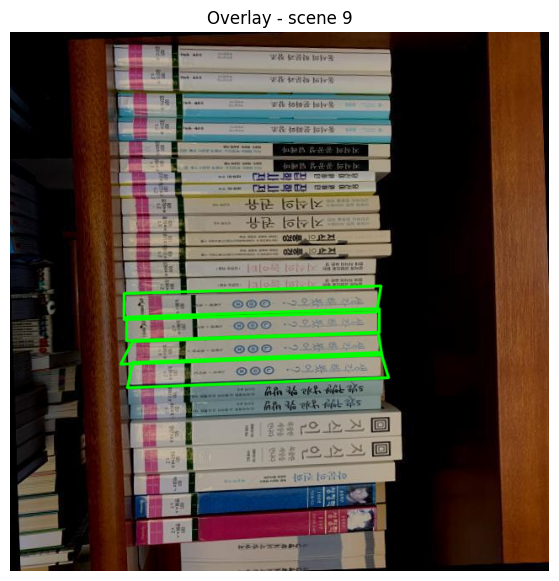

In [ ]:
def run_scene(scene_idx, debug=False):
    scene_rgb = imread_rgb(scene_paths[scene_idx])
    overlay = scene_rgb.copy()

    results = {}

    for model_idx in range(len(model_paths)):
        quads = detect_multiple_instances(model_idx, scene_idx, debug=debug)

        insts = [quad_to_instance(q) for q in quads]
        results[model_idx] = insts

        for q in quads:
            overlay = draw_quad(overlay, q)

    output_text = build_scene_output(scene_idx, results)
    print(output_text)
    show(overlay, f"Overlay - scene {scene_idx}", figsize=(10,7))
    return results, overlay, output_text

scene_name = "scene_9.jpg"
scene_idx = [i for i,p in enumerate(scene_paths) if os.path.basename(p)==scene_name][0]

results, overlay, txt = run_scene(scene_idx, debug=True)

## Full evaluation on all scenes

We run detection for every model book on every scene image.

For each scene:
- we compute detections per book type (possibly multiple instances),
- print results in the required format,
- generate an overlay visualization with all detected bounding quadrilaterals.

All outputs are stored in a JSON file for reproducibility.


In [ ]:
import os, json, math, glob

OUT_DIR = "outputs"
OVERLAY_DIR = os.path.join(OUT_DIR, "overlays")
os.makedirs(OVERLAY_DIR, exist_ok=True)

def run_one_scene(scene_idx, debug=False, thickness=2, print_text=True):
    scene_path = scene_paths[scene_idx]
    scene_rgb = imread_rgb(scene_path)
    overlay = scene_rgb.copy()

    results_by_model = {}

    for model_idx in range(len(model_paths)):
        quads = detect_multiple_instances(model_idx, scene_idx, debug=debug)

        instances = [quad_to_instance(q) for q in quads]
        results_by_model[model_idx] = instances

        for q in quads:
            overlay = draw_quad(overlay, q, book_idx=model_idx, thickness=thickness)

    # scene based text output
    output_text = build_scene_output(scene_idx, results_by_model, show_empty=False)

    if print_text:
        print(output_text)

    return results_by_model, overlay, output_text

def show_overlay_gallery(overlay_paths, cols=3, figsize_per_cell=(5,4)):
    n = len(overlay_paths)
    rows = math.ceil(n / cols)
    plt.figure(figsize=(cols*figsize_per_cell[0], rows*figsize_per_cell[1]))

    for i, p in enumerate(overlay_paths):
        ax = plt.subplot(rows, cols, i+1)
        ax.imshow(imread_rgb(p))
        ax.set_title(os.path.basename(p), fontsize=9)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

In [ ]:
def run_all_scenes(debug_scene_idx=None, thickness=2, save_outputs=True,
                   show_all_overlays=True, print_scene_text=True):
    all_results = {}

    for scene_idx, sp in enumerate(scene_paths):
        scene_name = os.path.basename(sp)
        debug = (scene_idx == debug_scene_idx)

        results_by_model, overlay_rgb, output_text = run_one_scene(
            scene_idx,
            debug=debug,
            thickness=thickness,
            print_text=print_scene_text
        )

        all_results[scene_name] = results_by_model

        if save_outputs:
            out_name = scene_name.replace(".jpg", "_overlay.jpg").replace(".png", "_overlay.png")
            out_path = os.path.join(OVERLAY_DIR, out_name)
            cv2.imwrite(out_path, cv2.cvtColor(overlay_rgb, cv2.COLOR_RGB2BGR))

    if save_outputs:
        json_path = os.path.join(OUT_DIR, "results.json")
        with open(json_path, "w") as f:
            json.dump(all_results, f, indent=2)
        print("\nSaved JSON to:", json_path)
        print("Saved overlays to:", OVERLAY_DIR)

    if show_all_overlays:
        overlay_paths = sorted(glob.glob(os.path.join(OVERLAY_DIR, "*_overlay.*")))
        show_overlay_gallery(overlay_paths, figsize_per_cell=(5.5,4.5))

    return all_results

In [ ]:
def book_output(all_results):
    """
    Prints final results grouped by Book index.
    One section per Book (Book 0, Book 1, ...).
    """
    book_to_instances = {i: [] for i in range(len(model_paths))}

    for scene_name, results_by_model in all_results.items():
        for model_idx, insts in results_by_model.items():
            for inst in insts:
                inst_with_scene = inst.copy()
                inst_with_scene["scene"] = scene_name
                book_to_instances[model_idx].append(inst_with_scene)

    for model_idx in range(len(model_paths)):
        insts = book_to_instances[model_idx]
        print(f"Book {model_idx} - {len(insts)} instance(s) found:")

        for i, inst in enumerate(insts, 1):
            print(
                f"  Instance {i} "
                f"{{top_left: {inst['top_left']}, "
                f"top_right: {inst['top_right']}, "
                f"bottom_left: {inst['bottom_left']}, "
                f"bottom_right: {inst['bottom_right']}, "
                f"area: {inst['area_px']:.0f}px}}"
            )

### Important note: we cleared the output related to the following code cell because there were images as well and it exploded the notebook size.

In [ ]:
all_results = run_all_scenes(
    debug_scene_idx=None,
    thickness=4,
    save_outputs=True,
    show_all_overlays=False,
    print_scene_text=True
)

The following implementations are purely for better visualization and formatting purposes. We display the book along side the scene it is associated with and the corresponding bounding boxes.

In [ ]:
def book_visualizations(all_results):
    """
    For each detected book in each scene:
    Left: model image
    Right: scene with overlays of that book only
    each instance has a different color
    """
    os.makedirs("outputs/book_views", exist_ok=True)

    for scene_name, results_by_model in all_results.items():
        scene_idx = [i for i,p in enumerate(scene_paths)
                     if os.path.basename(p)==scene_name][0]

        scene_rgb = imread_rgb(scene_paths[scene_idx])

        # to process models in order
        for model_idx in sorted(results_by_model.keys()):

            insts = results_by_model[model_idx]
            if len(insts) == 0:
                continue

            model_rgb = imread_rgb(model_paths[model_idx])
            overlay = scene_rgb.copy()

            # draw each instance in different color
            for i, inst in enumerate(insts):
                quad = np.array([
                    inst["top_left"],
                    inst["top_right"],
                    inst["bottom_right"],
                    inst["bottom_left"]
                ], dtype=np.float32)

                overlay = draw_quad(overlay, quad, book_idx=i, thickness=4)

            h_scene = overlay.shape[0]
            h_model = model_rgb.shape[0]
            scale = h_scene / h_model
            new_w = int(model_rgb.shape[1] * scale)
            model_resized = cv2.resize(model_rgb, (new_w, h_scene))

            gap_width = 50
            gap = np.ones((h_scene, gap_width, 3), dtype=np.uint8) * 255

            combined = np.hstack([model_resized, gap, overlay])

            out_name = f"model_{model_idx}_{scene_name}"
            out_path = os.path.join("outputs/book_views", out_name)

            cv2.imwrite(out_path,
                        cv2.cvtColor(combined, cv2.COLOR_RGB2BGR))

    print("Saved book visualizations to outputs/book_views")

To count the total instances we have detected.

In [ ]:
def count_total_instances(all_results):
    total = 0
    for scene_data in all_results.values():
        for inst_list in scene_data.values():
            total += len(inst_list)

    print(f"\nTotal instances detected: {total}")
    return total

In [ ]:
book_output(all_results)
count_total_instances(all_results)
book_visualizations(all_results)

Book 0 - 2 instance(s) found:
  Instance 1 {top_left: (209, 179), top_right: (243, 181), bottom_left: (209, 568), bottom_right: (243, 567), area: 13179px}
  Instance 2 {top_left: (169, 181), top_right: (204, 182), bottom_left: (174, 573), bottom_right: (209, 570), area: 13863px}
Book 1 - 2 instance(s) found:
  Instance 1 {top_left: (207, 247), top_right: (235, 249), bottom_left: (207, 554), bottom_right: (235, 554), area: 8685px}
  Instance 2 {top_left: (237, 247), top_right: (266, 246), bottom_left: (235, 551), bottom_right: (265, 552), area: 8950px}
Book 2 - 3 instance(s) found:
  Instance 1 {top_left: (257, 145), top_right: (302, 146), bottom_left: (257, 563), bottom_right: (302, 563), area: 18636px}
  Instance 2 {top_left: (308, 98), top_right: (374, 74), bottom_left: (297, 570), bottom_right: (352, 589), area: 29704px}
  Instance 3 {top_left: (427, 258), top_right: (454, 267), bottom_left: (397, 573), bottom_right: (443, 565), area: 11324px}
Book 3 - 2 instance(s) found:
  Instanc

The instances detected are 61, but it should be 60, because we treat the third instance of Book 2 in scene 27 as an extra detection (False positve)

More over, the 3 detections of model 11, in scenes 15, 16 and 17, are taken into account. If we were to be strict the differences inthe dots on the book spines might suggest that those detections should not have passed. Thus this could be a correct detection or false positive depending on the strictness of the assignment.

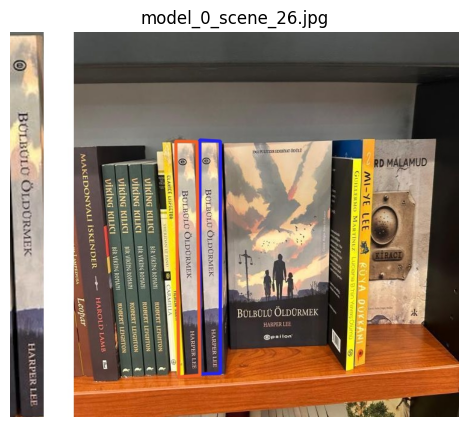

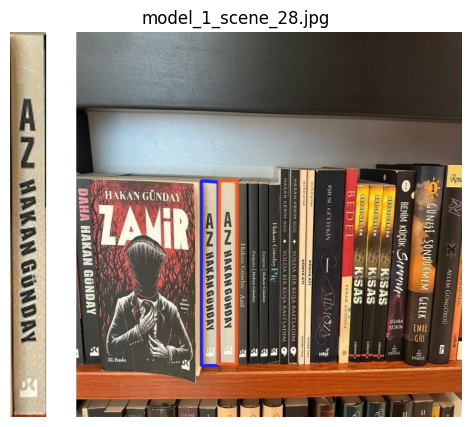

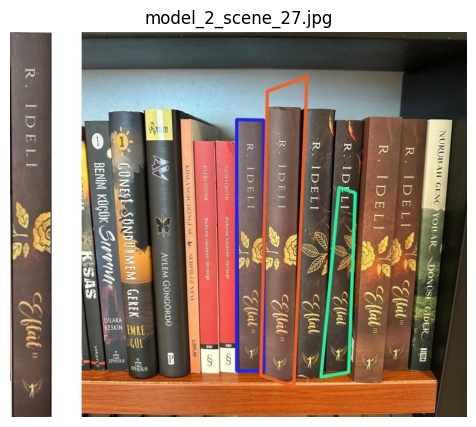

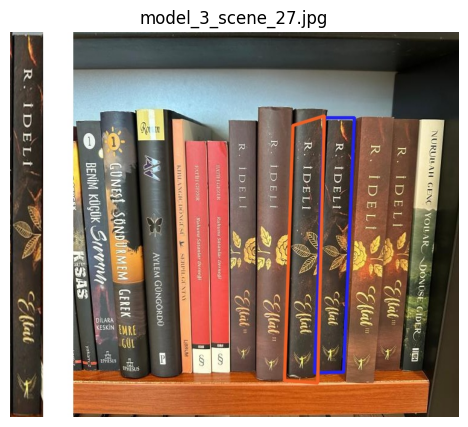

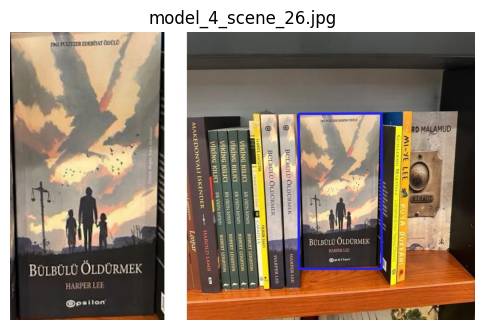

...

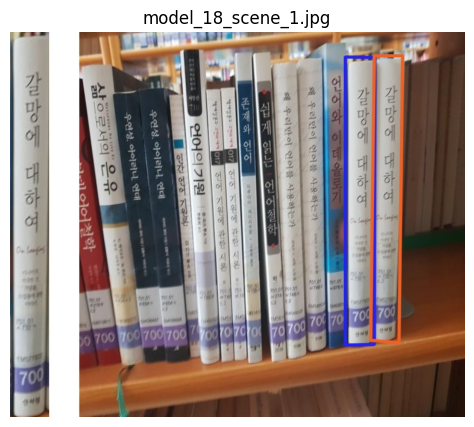

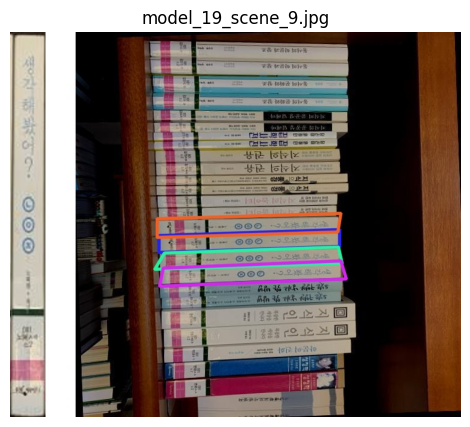

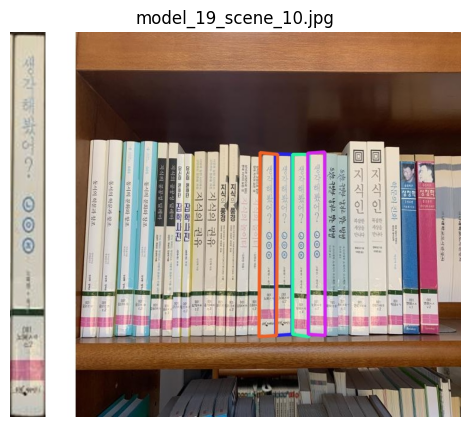

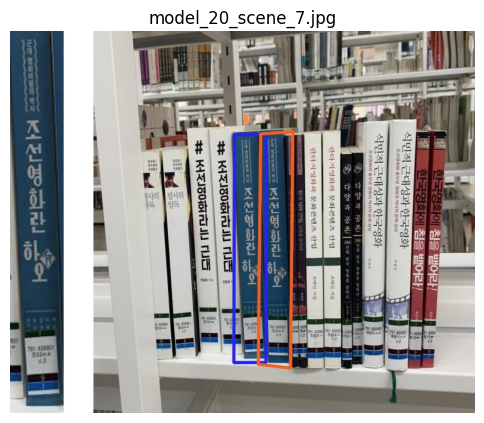

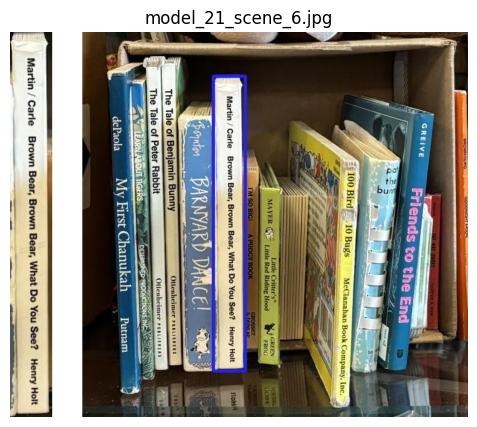

In [ ]:
folder = "outputs/book_views"

import re

def _model_id_from_name(name):
    m = re.search(r"model_(\d+)", name)
    return int(m.group(1)) if m else 10**9

for fname in sorted(os.listdir(folder), key=_model_id_from_name):
    path = os.path.join(folder, fname)
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(6,5))
    plt.title(fname)
    plt.imshow(img)
    plt.axis("off")
    plt.show()

# Conclusion

In this assignment, we developed a complete **classical computer vision pipeline** to detect and localize books on a shelf using traditional image processing and feature-based methods.

Starting from careful **preprocessing** (denoising and contrast enhancement), we extracted robust **SIFT keypoints and descriptors** from both reference book images and shelf scenes. Descriptor matching combined with **ratio tests and RANSAC-based homography estimation** allowed us to reliably identify planar correspondences between models and scenes. By iteratively removing scene keypoints belonging to already detected instances, the system was able to correctly handle **multiple instances of the same book** within a single scene.

To improve robustness and avoid false positives, we enforced several **geometric and quality constraints**, including minimum inlier counts, inlier ratios, reprojection error checks, and spine-like shape validation. These constraints ensured that detected bounding boxes were well aligned with book spines or covers and did not drift onto neighboring books. Each detection was represented as a quadrilateral, which allowed us accurate reporting of **position, orientation, and area** in pixel space.

The final outputs reports:
- the **number of instances per book** is reported,
- each instance includes the **four bounding box corners and area**,
- and **overlay visualizations** with distinct colors per book are provided for all scene images.

## Results

The detection is mostly accurate with outlier cases, specifically:

*   **Book 2** in **Scene 27**, there is an extra detection but the bounding box barely covers the books pine, it is the same book but with dark shade. We leave this detection as is, as it passed the ratio test barely.
In another instance, there is correct detection but the bounding box overshoots. In general, it is an expected trade off very few false positives, if we can achieve greater than 90% accuracy on correct instances.  

*   **Book 11,** is correctly detected in **scenes 17, 16 and 15**, each two instances. However, one of the target books has a subtle difference in the dots ( 1 less dot on the book spine). But we treat it as the same book and still believe our detection is robust enough. The bounding box in one instance overshoots a bit, but we think this is due to a change in illumination.



Overall, the results demonstrate that a carefully designed **feature-based, non-learning approach** aka the classical method, can effectively solve a real-world object recognition task such as product identification on shelves. of course its main limitation arising from scene variations which would need to be accounted for, this work highlights the continued relevance and interpretability of classical computer vision techniques when they are applied thoughtfully and systematically.


End of the experiment.